<a href="https://colab.research.google.com/github/ahmtox/swept-plane-scanner/blob/main/scanner_notebookt_es143.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Setup

In [64]:
# Mount your google drive. This will launch a pop-up window for authentication.

from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [65]:
# YOU SHOULD HAVE ALREADY COPIED THE ASSIGNMENT FILES TO THIS
# FOLDER ON YOUR GOOGLE DRIVE

#cd your_path_here
%cd "/content/drive/MyDrive/Scanner"

/content/drive/MyDrive/Scanner


In [66]:
# Install pupil_apriltags package. This a wrapper for the Apriltags3 library developed by AprilRobotics.
# Documentation at https://github.com/pupil-labs/apriltags

%pip install pupil-apriltags

In [67]:
#@title imports
# Import required libraries here
import cv2                               # OpenCV
import numpy as np                       # numpy
import os
from pupil_apriltags import Detector
import requests
import pickle
import glob   # filename and path management for file I/O

import plotly.express as px
import plotly.graph_objects as go

# Use this line to make matplotlib plot inline (only need to call it once when importing matplotlib)
%matplotlib inline

import matplotlib.pyplot as plt
# Modify this line to adjust the displayed plot size. You can also call
# it with different parameters or use plt.figure(figsize=[H, W]) before specific plots.
plt.rcParams['figure.figsize'] = [10, 10]

In [68]:
#@title aprilboard data
# Fetch lists of target-IDs and 2D target locations (in inches) corresponding to the two
#   printed April boards.
response = requests.get("https://github.com/Harvard-CS283/pset-data/raw/f1a90573ae88cd530a3df3cd0cea71aa2363b1b3/april/AprilBoards.pickle")
data = pickle.loads(response.content)

at_coarseboard = data['at_coarseboard']
at_fineboard = data['at_fineboard']

In [69]:
#@title Helper function: `detect_aprilboard()`
# set up april tag detector (I use default parameters; seems to be OK)
at_detector = Detector(families='tag36h11',
                       nthreads=1,
                       quad_decimate=1.0,
                       quad_sigma=0.0,
                       refine_edges=1,
                       decode_sharpening=0.25,
                       debug=0)

def detect_aprilboard(img, board, apriltag_detector):
    # Usage:  imgpoints, objpoints, tag_ids = detect_aprilboard(img,board,AT_detector)
    #
    # Input:
    #   image -- grayscale image
    #   board -- at_coarseboard or at_fineboard (list of dictionaries)
    #   AT_detector -- AprilTag Detector parameters
    #
    # Returns:
    #   imgpoints -- Nx2 numpy array of (x,y) image coords
    #   objpoints -- Nx3 numpy array of (X,Y,Z=0) board coordinates (in inches)
    #   tag_ids -- Nx1 list of tag IDs

    imgpoints=[]
    objpoints=[]
    tagIDs=[]

    # detect april tags
    imgtags = apriltag_detector.detect(img,
                                    estimate_tag_pose=False,
                                    camera_params=None,
                                    tag_size=None)

    if len(imgtags):
        # collect image coordinates of tag centers
        # imgpoints = np.vstack([ sub.center for sub in tags ])

        # list of all tag_id's that are in board
        brdtagIDs = [ sub['tag_id'] for sub in board ]

        # list of all detected tag_id's that are in image
        imgtagIDs = [ sub.tag_id for sub in imgtags ]

        # list of all tag_id's that are in both
        tagIDs = list(set(brdtagIDs).intersection(imgtagIDs))

        if len(tagIDs):
            # all board list-elements that contain one of the common tag_ids
            objs=list(filter(lambda tagnum: tagnum['tag_id'] in tagIDs, board))

            # their centers
            objpoints = np.vstack([ sub['center'] for sub in objs ])

            # all image list-elements that contain one of the detected tag_ids
            imgs=list(filter(lambda tagnum: tagnum.tag_id in tagIDs, imgtags))

            # their centers
            imgpoints = np.vstack([ sub.center for sub in imgs ])

    return imgpoints, objpoints, tagIDs

def in2hom(X):
    return np.concatenate([X, np.ones((X.shape[0], 1), dtype=np.float32)], axis=1)

# Convert from Nxm homogeneous to Nx(m-1) inhomogeneous coordinates
def hom2in(X):
    return X[:, :-1] / X[:, -1:]

def intersect_ray_plane(plane, impts, calMatrix, distCoeffs):
    """
    3D intersection points from back-projected camera rays and a 3D plane

    Args:
      plane:      (a,b,c,d) plane parameters in camera coordinate system
      impts:      Nx2 array of pixel coordinates (xi,yi) to be back-projected
      calMatrix:  K-matrix as returned by cv2.calibrateCamera()
      distCoeffs: optical distortion coefficients as returned by cv2.calibrateCamera()

    Returns:
      intersections:  Nx3 array of 3D intersection-point coordinates (Xi,Yi,Zi)
    """

    # compute normalized coordinates (analogous to K^{-1}*x)
    impts_norm = cv2.undistortPoints(impts, calMatrix, distCoeffs)

    # remove extraneous leading size-1 axis that openCV returns (annoying)
    impts_norm = np.squeeze(impts_norm)

    # back-projections are homogeneous versions of these
    backproj = in2hom(impts_norm)

    # ray-plane intersection (use equation derived from Class Session slides)
    intersections_lambda = -plane[3]/np.dot(backproj,plane[:3])
    intersections = np.expand_dims(intersections_lambda,axis=1)*backproj

    return intersections

In [70]:
# @title Helper function: add_plotly_camera and add_plotly_plane
def add_plotly_camera(h,w,camera,raysize,figobj):
# Add tetrahedral camera to pyplot figure
# h,w:      height and width of image in pixels
# camera:   3x4 camera matrix
# raysize:  length of tetrahedral edges (in world units)
# fig:      pyplot figure object
#
# Returns: 1
#
# Uses anatomy of camera matrices from Hartley and Zisserman Chapter 6

    # normalize camera such that bottom-left three-vector
    #   corresponds to unit-length principal ray in front of camera (HZ Section 6.2.3)
    camera=camera*np.sign(np.linalg.det(camera[:,0:3]))/np.linalg.norm(camera[2,0:3])

    # Compute camera center (null vector of P)
    _, _, v = np.linalg.svd(camera)
    C = np.transpose(v[-1,0:3]) / v[-1,3]

    # Back-project image corners to unit-length 3D ray segments:
    S = np.array([[0, 0, 1],       # homog image coords if top left pixel
                  [0, h-1, 1],     # bottom left
                  [w-1, h-1, 1],   # bottom right
                  [w, 0, 1]])      # top right

    #   HZ equation (6.14): compute one 3D point along each ray
    X = np.transpose(np.linalg.lstsq(
        camera[:,0:3],
        np.transpose(S)-np.expand_dims(camera[:,3],axis=1),
        rcond=None)[0])

    #   unit-vectors from camera center to each 3D point
    V = X - np.tile(C, (4, 1))
    V = V / np.linalg.norm(V, ord=2, axis=1, keepdims=True)

    # make sure these vectors point forwards from the camera instead of backwards
    V = V*np.expand_dims(np.sign(np.sum(V * np.tile(camera[2,0:3],(4, 1)), axis=1)),axis=1)

    #   desired ray segments that are length raysize in these directions
    V = np.tile(C, (4, 1)) + raysize * V

    # append the camera center itself to complete the four tetrahedral vertices
    V=np.vstack([C,V])

    # add camera center to figure
    figobj.add_trace(go.Scatter3d(
        x=[C[0]],
        y=[C[1]],
        z=[C[2]],
        mode='markers',
        marker=dict(
            size=3,
            color='#ff7f0e'
        )
    )
                    )


    # add tetrahedron to figure
    figobj.add_trace(go.Mesh3d(
        # vertices of tetrahedron
        x=V[:,0],
        y=V[:,1],
        z=V[:,2],

        # i, j and k give the vertices of triangles
        i=[0, 0, 0, 0],
        j=[1, 2, 3, 4],
        k=[2, 3, 4, 1],
        opacity=0.5,
        color='#ff7f0e'
    ))

    return 1

def add_plotly_plane(plane,figobj):
# Add 3D plane to pyplot figure
# plane:   (a,b,c,d) plane parameters
# fig:      pyplot figure object
#
# Returns: 1
#
# Note: this function only works for this assignment's particular set of planes

    # create regular grid of X,Y,Z values that span the volume that is relevant to
    # this assignment's planes
    #   (numpy.mgrid trick: j (complex) in step size forces inclusion of stop value)
    X, Y, Z = np.mgrid[-10:10:40j, -18:10:40j, 20:42:40j]

    # evaluate the linear functions on this volumetric grid that is zero at the plane
    implicitplane = plane[0]*X + plane[1]*Y + plane[2]*Z + plane[3]

    # display using plotly's isosurface trace
    figobj.add_trace(go.Isosurface(
          x=X.flatten(),
          y=Y.flatten(),
          z=Z.flatten(),
          value=implicitplane.flatten(),
          isomin=0,
          isomax=0,
          opacity=0.3,
          colorscale='blues',
          showscale=False, # remove colorbar
          ))

    return 1

In [71]:
#@title helper functions: `in2hom()` and `hom2in()`
# Convert from Nxm inhomogeneous to Nx(m+1) homogeneous coordinates
def in2hom(X):
    return np.concatenate([X, np.ones((X.shape[0], 1), dtype=np.float32)], axis=1)

# Convert from Nxm homogeneous to Nx(m-1) inhomogeneous coordinates
def hom2in(X):
    return X[:, :-1] / X[:, -1:]

# Calibrate Camera

In [72]:
#@title extract keyframes
!ffmpeg -i ./data/calibration.mov -vf "select='eq(pict_type,I)', extractplanes=y" -pix_fmt gray -vsync vfr -q:v 2 ./data/out_keyframes_%04d.png

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

27 images:
0 ./data/out_keyframes_0001.png: 73 imgpts, 73 objpts
1 ./data/out_keyframes_0002.png: 78 imgpts, 78 objpts
2 ./data/out_keyframes_0003.png: 80 imgpts, 80 objpts
3 ./data/out_keyframes_0004.png: 80 imgpts, 80 objpts
4 ./data/out_keyframes_0005.png: 80 imgpts, 80 objpts
5 ./data/out_keyframes_0006.png: 80 imgpts, 80 objpts
6 ./data/out_keyframes_0007.png: 80 imgpts, 80 objpts
7 ./data/out_keyframes_0008.png: 80 imgpts, 80 objpts
8 ./data/out_keyframes_0009.png: 80 imgpts, 80 objpts
9 ./data/out_keyframes_0010.png: 80 imgpts, 80 objpts
10 ./data/out_keyframes_0011.png: 80 imgpts, 80 objpts
11 ./data/out_keyframes_0012.png: 80 imgpts, 80 objpts
12 ./data/out_keyframes_0013.png: 80 imgpts, 80 objpts
13 ./data/out_keyframes_0014.png: 80 imgpts, 80 objpts
14 ./data/out_keyframes_0015.png: 80 imgpts, 80 objpts
15 ./data/out_keyframes_0016.png: 80 imgpts, 80 objpts
16 ./data/out_keyframes_0017.png: 80 imgpts, 80 objpts
17 ./data/out_keyframes_0018.png: 80 imgpts, 80 objpts
18 ./data

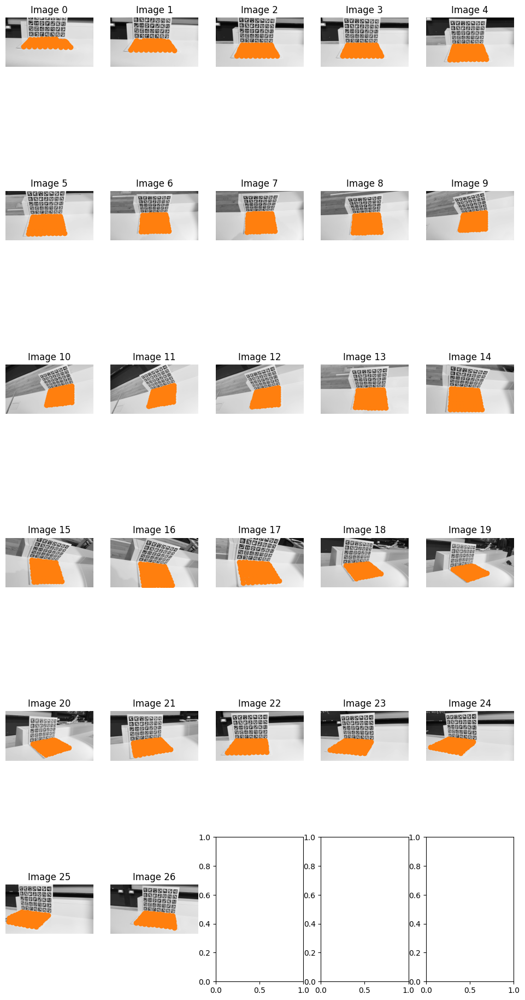

In [73]:
#@title detect fiducials

N = 70 # only use images with at least N detected objects for calibration
total_valid = 0

# Edit this line to point to the collection of input calibration image
CALIBFILES = './data/out_keyframes_*.png'

# Uncomment one of the following two lines to indicate which AprilBoard is being used (fine or coarse)
BOARD = at_fineboard
#BOARD = at_coarseboard

###### BEGIN CALIBRATION SCRIPT

# exit if no images are found or if BOARD is unrecognized
images = glob.glob(CALIBFILES)
assert images, "no calibration images matching: " + CALIBFILES
assert BOARD==at_fineboard or BOARD==at_coarseboard, "Unrecognized AprilBoard"

# else continue
print("{} images:".format(len(images)))

# initialize 3D object points and 2D image points
calObjPoints = []
calImgPoints = []

# define the number of columns for the plot, then calculate number of rows
num_plot_cols = 5
num_plot_rows = (len(images) + num_plot_cols - 1) // num_plot_cols

# create the figure and axes; flatten the axes array for convenvience
fig, axs = plt.subplots(num_plot_rows, num_plot_cols, figsize=(12, 4*num_plot_rows))
axs = axs.flatten()

# loop through the images
for count,fname in enumerate(images):

    # read image and convert to grayscale if necessary
    orig = cv2.imread(fname)
    if len(orig.shape) == 3:
        img = cv2.cvtColor(orig, cv2.COLOR_RGB2GRAY)
    else:
        img = orig

    # show image
    axs[count].imshow(img / 255.0, cmap="gray")
    axs[count].set_axis_off()
    axs[count].set_title("Image {}".format(count))

    # detect apriltags and report number of detections
    imgpoints, objpoints, tagIDs = detect_aprilboard(img,BOARD,at_detector)
    #print("{} {}: {} imgpts, {} objpts".format(count, fname, len(imgpoints),len(objpoints)))
    print(f"{count} {fname}: {len(imgpoints)} imgpts, {len(objpoints)} objpts")

    # append detections if some are found
    if len(imgpoints) >= N and len(objpoints) >= N:
        total_valid += 1
        # display detected tag centers
        axs[count].scatter(imgpoints[:,0], imgpoints[:,1], marker='o', color='#ff7f0e')

        # append points detected in all images, (there is only one image now)
        calObjPoints.append(objpoints.astype('float32'))
        calImgPoints.append(imgpoints.astype('float32'))

# plt.show()

In [74]:
#@title calibrate camera

# calibrate the camera
reprojerr, calMatrix, distCoeffs, calRotations, calTranslations = cv2.calibrateCamera(
    calObjPoints,
    calImgPoints,
    img.shape,    # uses image H,W to initialize the principal point to (H/2,W/2)
    None,         # no initial guess for the remaining entries of calMatrix
    None,         # initial guesses for distortion coefficients are all 0
    flags = None) # default contstraints (see documentation)

# Print output, including reprojection error, which is the root mean square (RMS)
#   re-projection error in pixels. If this value is much greater than 1, it is
#   likely to be a bad calibration.  Examine the images and detections, and the
#   options given to cv2.calibrateCamera() to figure out what went wrong.
np.set_printoptions(precision=5, suppress=True)
print('RMSE of reprojected points:', reprojerr)
print('Distortion coefficients:', distCoeffs)

np.set_printoptions(precision=2, suppress=True)
print('Intrinsic camera matrix:\n', calMatrix)
print('Total images used for calibration: ', total_valid)

RMSE of reprojected points: 1.8883864244056956
Distortion coefficients: [[-0.24262  1.41533  0.01165 -0.08868 -1.84243]]
Intrinsic camera matrix:
 [[1786.71    0.    571.02]
 [   0.   2160.2   914.48]
 [   0.      0.      1.  ]]
Total images used for calibration:  27


In [75]:
#@title Compute reprojection error separately in each image

# initial array for storing per-image reprojection errors
mean_errors=[]

# project 3D board points into the images, and compute the per-image reprojection error
for i in range(len(calObjPoints)):
    imgpoints2, _ = cv2.projectPoints(calObjPoints[i], calRotations[i], calTranslations[i], calMatrix, distCoeffs)
    mean_errors.append(np.mean(np.linalg.norm(calImgPoints[i] - np.squeeze(imgpoints2),axis=1)))

print("Per-image reprojection errors:")

# Print the list of per-image reprojection errors with at most 5 elements per line
print('\n'.join([', '.join([f"{error:.{5}f}" for error in mean_errors[i:i+5]]) for i in range(0, len(mean_errors), 5)]))

Per-image reprojection errors:
1.18596, 1.23723, 1.32983, 1.31309, 1.33224
1.36578, 1.45299, 2.12599, 1.68115, 1.41006
1.24137, 1.38152, 1.28217, 1.43554, 2.44281
3.62358, 2.87618, 2.10786, 0.99096, 0.94662
1.03511, 1.38667, 1.14265, 0.87873, 0.98889
1.14648, 1.37790


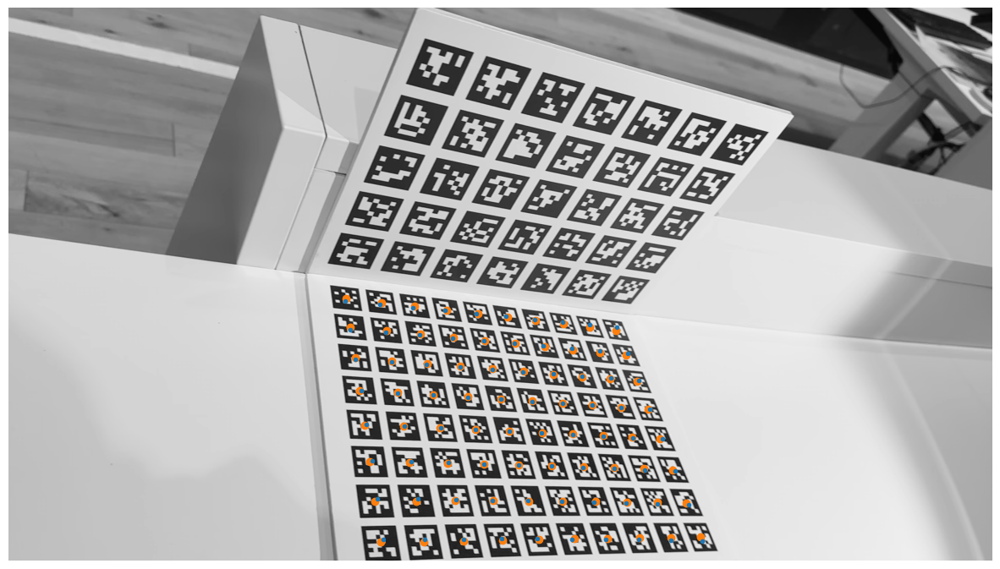

In [76]:
#@title Display the projected points in one of the images

# change this to select which calibration image to display
IMNUM=16

# read image and convert to grayscale if necessary
orig = cv2.imread(images[IMNUM])
if len(orig.shape) == 3:
    img = cv2.cvtColor(orig, cv2.COLOR_RGB2GRAY)
else:
    img = orig

# create figure, show image
fig,ax =plt.subplots(figsize=(15,15))
ax.imshow(img / 255.0, cmap="gray")
ax.set_axis_off()

# show detected points (in orange)
ax.scatter(calImgPoints[IMNUM][:,0], calImgPoints[IMNUM][:,1], marker='o', color='#ff7f0e')

# compute reprojections
imgpoints2, _ = cv2.projectPoints(calObjPoints[IMNUM],
                                  calRotations[IMNUM],
                                  calTranslations[IMNUM],
                                  calMatrix, distCoeffs)
imgpoints2=np.squeeze(imgpoints2) # eliminate the leading single dimension

# show reprojected points (in blue)
ax.scatter(imgpoints2[:,0], imgpoints2[:,1], marker='.', color='#1f77b4')

# Python Functions

### computeTwoPlanes()

In [77]:
# SET OUTPUT PRECISION
np.set_printoptions(precision=4)

In [78]:
#@title computeTwoPlanes()

def computeTwoPlanes(calMatrix, distCoeffs, image_path):
    # read image and convert to grayscale if necessary
    orig = cv2.imread(image_path)
    if len(orig.shape) == 3:
        img = cv2.cvtColor(orig, cv2.COLOR_RGB2GRAY)
    else:
        img = orig

    # detect apriltags and report number of detections. Do this for both boards (fine and coarse).
    imgpoints_fine, objpoints_fine, tagIDs_fine = detect_aprilboard(img,at_fineboard,at_detector)
    imgpoints_coarse, objpoints_coarse, tagIDs_coarse = detect_aprilboard(img,at_coarseboard,at_detector)

    # compute normalized image coordinates (equivalent to K^{-1}*x)
    # OUTPUTS Nx2, a 2-vector for the back-projected ray of each of N points
    imgpts_fine_norm = cv2.undistortPoints(imgpoints_fine, calMatrix, distCoeffs)
    imgpts_coarse_norm = cv2.undistortPoints(imgpoints_coarse, calMatrix, distCoeffs)

    # homographies from each board to normalized image pts
    # RETURNS H = [r1, r2, t]
    H_fine,_ = cv2.findHomography(objpoints_fine[:,:2],imgpts_fine_norm)
    H_coarse,_ = cv2.findHomography(objpoints_coarse[:,:2],imgpts_coarse_norm)

    # extract rotation and translation from homography: fineboard
    H_fine = 2*H_fine/(np.linalg.norm(H_fine[:,0]) + np.linalg.norm(H_fine[:,1]))
    R_fine = np.hstack((H_fine[:,:2],np.atleast_2d(np.cross(H_fine[:,0],H_fine[:,1])).T))
    rvec_fine,_ = cv2.Rodrigues(R_fine)
    R_fine,_ = cv2.Rodrigues(rvec_fine)
    tvec_fine=H_fine[:,2]

    # extract rotation and translation from homography: coarseboard
    # SCALE H such that norms of r1 and r2 are close to 1
    H_coarse = 2*H_coarse/(np.linalg.norm(H_coarse[:,0]) + np.linalg.norm(H_coarse[:,1]))
    # ESTIMATES r3 (cross r1 r2). Now we have estimate of R, orthogonal and unit length columns
    R_coarse = np.hstack((H_coarse[:,:2],np.atleast_2d(np.cross(H_coarse[:,0],H_coarse[:,1])).T))
    # FIND real R that is closest to estimate R, outputs axis-angle representation
    rvec_coarse,_ = cv2.Rodrigues(R_coarse)
    # OUTPUTS 3x3 R
    R_coarse,_ = cv2.Rodrigues(rvec_coarse)
    tvec_coarse=H_coarse[:,2]

    pi_h = np.hstack([R_fine[:,2], np.dot(-R_fine[:,2].T, tvec_fine)])
    pi_v = np.hstack([R_coarse[:,2], np.dot(-R_coarse[:,2].T, tvec_coarse)])

    # print("pi_h", pi_h)
    # print("pi_v", pi_v)

    return pi_h, pi_v

In [81]:
#@title Test Code
print(calMatrix)
print(distCoeffs)
plane_h, plane_v = computeTwoPlanes(calMatrix, distCoeffs, './data2/twoboards.jpg')
plane_h, plane_v

[[1786.7136    0.      571.0229]
 [   0.     2160.1992  914.4825]
 [   0.        0.        1.    ]]
[[-0.2426  1.4153  0.0117 -0.0887 -1.8424]]


(array([-0.1761,  0.7362, -0.6534, 25.6987]),
 array([-0.173 , -0.8475, -0.5019, 11.0172]))

### processVideo()

In [85]:
from tqdm.notebook import tqdm


def processVideo(video_path, background_mask, foreground_mask, use_mask=True, chunk_size=100):

  """
    Processes a video to compute edge times and points where shadows cross in the foreground and background.

    Parameters:
        video_path (str): The path to the video file to process.
        background_mask (ndarray): A binary mask representing the background areas of the video.
        foreground_mask (ndarray): A binary mask representing the foreground areas of the video.
        use_mask (bool, optional): If True, the function uses the provided masks to isolate the background and
                                   foreground. Defaults to True.
        chunk_size (int, optional): The number of frames to process in a single batch. Defaults to 100.

    Returns:
        tuple: A tuple containing two elements:
               - The first element is an ndarray representing the times at which shadow edges are detected in the
                 foreground mask.
               - The second element is an ndarray of points representing the locations of shadow edges in the
                 background mask.
    """

  print('Computing Min-Max Values')
  min_values, max_values, height, width = compute_min_max_values(video_path)

  print('Computing Shadow')
  shadow_threshold = compute_shadow(min_values, max_values)

  print('Finding Shadow Edges in Background Mask')
  bg_edge_points = compute_shadow_edge_background(
      video_path, background_mask, shadow_threshold, height, width, use_mask=use_mask)

  print('Finding Shadow Cross-times in Foreground Mask')
  fg_edge_times = compute_shadow_edge_foreground(
      video_path, foreground_mask, shadow_threshold, height, width, use_mask=use_mask, chunk_size=chunk_size)

  print('Done!')

  return fg_edge_times, bg_edge_points


def compute_min_max_values(video_path):

  """
    Computes the minimum and maximum grayscale values for each pixel across all frames of the video.

    Parameters:
        video_path (str): The path to the video file.

    Returns:
        tuple: A tuple containing the following elements:
               - min_values (ndarray): An array of the minimum pixel values.
               - max_values (ndarray): An array of the maximum pixel values.
               - height (int): The height of the video frames.
               - width (int): The width of the video frames.
    """

  cap = cv2.VideoCapture(video_path)

  width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
  height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

  min_values = np.full((height, width), np.inf)
  max_values = np.full((height, width), -np.inf)

  while cap.isOpened():

    ret, frame = cap.read()

    if not ret:
      break

    if len(frame.shape) > 2:
      frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    else:
      frame_gray = frame

    min_values = np.minimum(min_values, frame_gray)
    max_values = np.maximum(max_values, frame_gray)

  cap.release()

  return min_values, max_values, height, width



def compute_shadow_edge_background(video_path, background_mask, shadow, height, width, use_mask=True):

  """
    Computes the shadow edge points in the background planes.

    Parameters:
        video_path (str): The path to the video file.
        background_mask (ndarray): A binary mask of the background.
        shadow (ndarray): An array representing the shadow threshold values.
        height (int): The height of the video frames.
        width (int): The width of the video frames.
        use_mask (bool, optional): Whether to apply the background mask to isolate the background. Defaults to True.

    Returns:
        ndarray: An array of points representing the locations of shadow edges in the background.
    """

  cap = cv2.VideoCapture(video_path)

  if (int(background_mask.shape[0]) != int(height) or int(background_mask.shape[1]) != int(width)):
      raise ValueError("Mask and Video frames have different shapes")

  edge_shadow_points = []

  while cap.isOpened():
    ret, frame = cap.read()
    frame_edge_shadow_points = []

    if not ret:
      break

    if len(frame.shape) > 2:
          frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    else:
        frame_gray = frame

    relative_frame = frame_gray - shadow

    if use_mask:
      relative_frame *= background_mask

    for i in range(relative_frame.shape[0]):
      row = relative_frame[i, :]
      if np.any(row != 0.0):
        signs = np.sign(row)
        diff = np.diff(signs)
        diff_ind = (diff == 2)
        idx_crossings = np.where(diff_ind)[0]
        if idx_crossings.size == 0:
          frame_edge_shadow_points.append((-1, i))
        else:
          last_idx_crossing = idx_crossings[-1]
          px_val_before_crossing = row[last_idx_crossing]
          px_val_after_crossing = row[last_idx_crossing + 1]

          x_zero = compute_zero_crossing_vectorized(last_idx_crossing, px_val_before_crossing, px_val_after_crossing)

          frame_edge_shadow_points.append((x_zero, i))

      else:
        frame_edge_shadow_points.append((-1, i))

    edge_shadow_points.append(frame_edge_shadow_points)

  cap.release()

  return np.array(edge_shadow_points)



def compute_shadow_edge_foreground(video_path, foreground_mask, shadow, height, width, chunk_size=100, use_mask=True):

  """
    Computes the times at which shadow edges cross the foreground elements in the video.

    Parameters:
        video_path (str): The path to the video file.
        foreground_mask (ndarray): A binary mask of the foreground.
        shadow (ndarray): An array representing the shadow threshold values.
        height (int): The height of the video frames.
        width (int): The width of the video frames.
        chunk_size (int, optional): The number of frames to process in a single batch. Defaults to 100.
        use_mask (bool, optional): Whether to apply the foreground mask to isolate the foreground elements. Defaults to True.

    Returns:
        ndarray: An array representing the times at which shadow edges are detected in the foreground mask.
    """

  rows, cols = foreground_mask.shape
  if int(rows) != int(height) or int(cols) != int(width):
      raise ValueError("Mask and video frames have different shapes")

  cap = cv2.VideoCapture(video_path)
  total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
  edge_times = np.full((height, width), -1)


  chunks = [(start, min(start + chunk_size, total_frames)) for start in range(0, total_frames, chunk_size)]

  for start, end in tqdm(chunks):
    chunk_frames = []
    chunk_edge_times = np.full((height, width), -1)
    for frame_index in range(start, end + 1):
      cap.set(cv2.CAP_PROP_POS_FRAMES, frame_index)
      ret, frame = cap.read()

      if not ret:
        break
      if len(frame.shape) > 2:
        frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
      else:
        frame_gray = frame

      relative_frame = frame_gray - shadow
      chunk_frames.append(relative_frame)

    chunk_frames = np.array(chunk_frames)

    signs = np.sign(chunk_frames)
    diff = np.diff(signs, axis = 0)
    diff_ind = (diff == -2)
    idx_frame, idx_height, idx_width = np.where(diff_ind)
    px_vals_before_crossing = chunk_frames[idx_frame, idx_height, idx_width]
    px_vals_after_crossing = chunk_frames[idx_frame + 1, idx_height, idx_width]

    crossings = compute_zero_crossing_vectorized(
        idx_frame,
        px_vals_before_crossing,
        px_vals_after_crossing
    )

    crossings += start

    chunk_edge_times[idx_height, idx_width] = crossings

    edge_times = np.maximum(edge_times, chunk_edge_times)


    del chunk_frames

  edge_times = edge_times.astype(float)
  edge_times[edge_times == total_frames*10] = -1

  if use_mask:
    edge_times *= foreground_mask
    edge_times[edge_times == 0] = -1

  return edge_times


def compute_zero_crossing_vectorized(idx_frame, vals_before_crossing, vals_after_crossing):

  """
    Computes the exact frame indices where zero crossings occur, given pixel values before and after the crossing.

    Parameters:
        idx_frame (ndarray): An array of frame indices just before the crossing.
        vals_before_crossing (ndarray): An array of pixel values just before the crossing.
        vals_after_crossing (ndarray): An array of pixel values just after the crossing.

    Returns:
        ndarray: An array of the computed exact frame indices of zero crossings.
    """

  idx_frame_plus_one = idx_frame + 1

  m = np.divide(
      np.subtract(vals_after_crossing, vals_before_crossing),
      np.subtract(idx_frame_plus_one, idx_frame)
  )
  x_zeros = np.add(idx_frame, np.divide(
      np.negative(vals_before_crossing),
      m
  ))

  return x_zeros


def compute_shadow(min_values, max_values):

  """
    Computes the shadow threshold values by averaging the minimum and maximum pixel values.

    Parameters:
        min_values (ndarray): An array of the minimum pixel values across all frames.
        max_values (ndarray): An array of the maximum pixel values across all frames.

    Returns:
        ndarray: An array representing the shadow threshold values.
    """
  shadow = (max_values + min_values) / 2
  return shadow



In [86]:
from PIL import Image

video_path = "shadow_sweep.mov"
background_mask = cv2.imread('mask_boards.jpg', cv2.IMREAD_GRAYSCALE)
foreground_mask = cv2.imread('mask_object.jpg', cv2.IMREAD_GRAYSCALE)
background_mask_norm = background_mask / 255.0
foreground_mask_norm = foreground_mask / 255.0

front_edge_times, background_edge_points = processVideo(video_path, background_mask_norm, foreground_mask_norm, chunk_size=50)

print("Front edge times shape:", front_edge_times.shape)
print("max", np.max(front_edge_times))
print("min", np.min(front_edge_times))
print("Front edge times:\n", front_edge_times)

img = Image.fromarray(front_edge_times, 'L')
img.show()

Computing Min-Max Values
Computing Shadow
Finding Shadow Edges in Background Mask
Finding Shadow Cross-times in Foreground Mask


  0%|          | 0/8 [00:00<?, ?it/s]

Done!
Front edge times shape: (1080, 1920)
max 376.0
min -1.0
Front edge times:
 [[-1. -1. -1. ... -1. -1. -1.]
 [-1. -1. -1. ... -1. -1. -1.]
 [-1. -1. -1. ... -1. -1. -1.]
 ...
 [-1. -1. -1. ... -1. -1. -1.]
 [-1. -1. -1. ... -1. -1. -1.]
 [-1. -1. -1. ... -1. -1. -1.]]


Computing Min-Max Values
Computing Shadow
Finding Shadow Edges in Background Mask
Finding Shadow Cross-times in Foreground Mask


  0%|          | 0/8 [00:00<?, ?it/s]

Done!


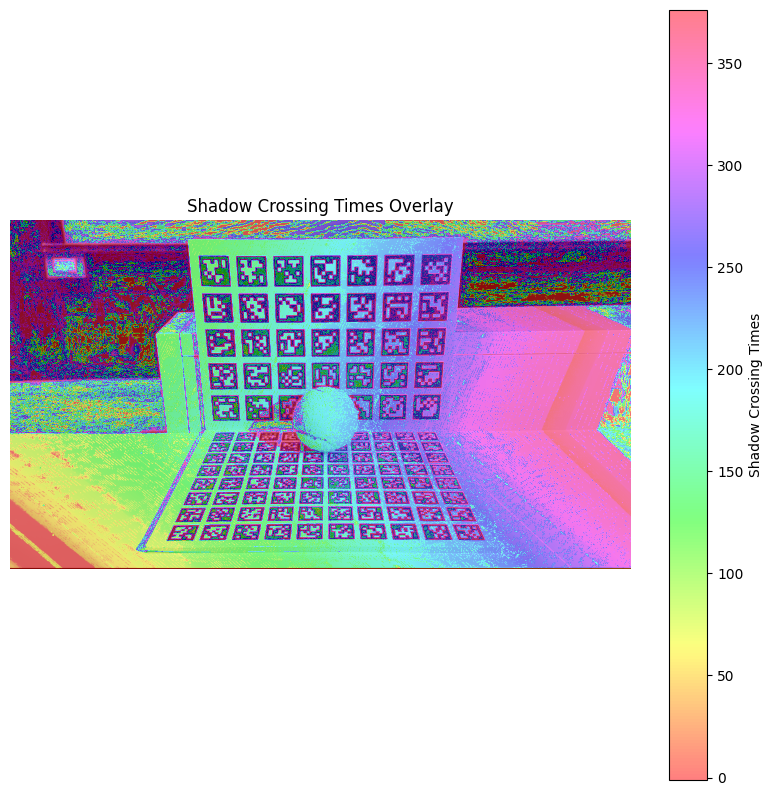

In [89]:
front_edge_times_plot, background_edge_points_plot = processVideo(video_path, background_mask_norm, foreground_mask_norm, chunk_size=50, use_mask=False)


cap = cv2.VideoCapture(video_path)

ret, frame = cap.read()

if ret:
    # Convert the frame to grayscale
    frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Display the grayscale frame
    plt.imshow(frame_gray, cmap='gray')

    # Overlay the shadow crossing times using a colormap
    # Adjust 'alpha' to make the overlay transparent, if desired
    plt.imshow(front_edge_times_plot, cmap='hsv', alpha=0.5)

    # Add a colorbar to indicate the scale of the shadow crossing times
    plt.colorbar(label='Shadow Crossing Times')

    # Additional plot adjustments
    plt.title('Shadow Crossing Times Overlay')
    plt.axis('off')  # Hide axis ticks
    plt.show()
else:
    print("Failed to read the first frame of the video.")

# Release the video capture object
cap.release()

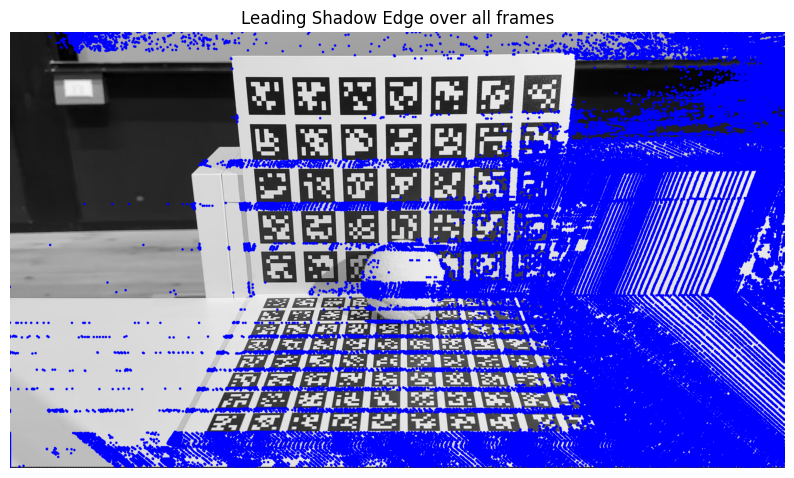

In [90]:
# Open the video file
cap = cv2.VideoCapture(video_path)

# Attempt to read the first frame
ret, frame = cap.read()

if ret:
    # Convert the first frame to grayscale
    frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Convert the grayscale image to BGR for colored points
    frame_with_points = cv2.cvtColor(frame_gray, cv2.COLOR_GRAY2BGR)

    # Example (frames, rows, 2) array, replace with your actual data
    frames, rows = 378, 1080

    # Define a colormap
    colors = plt.cm.jet(np.linspace(0, 1, frames))

    for i, points in enumerate(background_edge_points_plot):
        color = (255, 0 ,0)

        # Plot each point
        for pt in points:
            # Ensure the points are tuples of integers
            pt = tuple(map(int, pt))

            # Plot the point on the frame
            cv2.circle(frame_with_points, pt, 3, color, -1)  # Color is reversed (BGR)

    # Display the image
    plt.imshow(cv2.cvtColor(frame_with_points, cv2.COLOR_BGR2RGB))
    plt.title('Leading Shadow Edge over all frames')
    plt.axis('off')
    plt.show()
else:
    print("Failed to read the first frame of the video.")

# Release the video capture object
cap.release()

### computeShadowPlanes()

In [ ]:
import numpy as np
import cv2

f1 = './mask_higher.jpg'
f2 = './mask_lower.jpg'
mask_high = cv2.imread(f1)
mask_low = cv2.imread(f2)

def computeShadowPlanes(mask_higher, mask_lower, bg_edge_points, pi_v, pi_h, calMatrix, distCoeffs):
  shadow_planes = np.zeros((bg_edge_points.shape[0],4))

  for i, frame in enumerate(bg_edge_points):

    # Step 1: Split the matrix into two halves
    mid_index = frame.shape[0] // 2
    first_half = frame[:mid_index]
    second_half = frame[mid_index:]

    # Step 2: Filter out rows where the first term is not -1 in each half
    top_section = first_half[first_half[:, 0] != -1]
    bottom_section = second_half[second_half[:, 0] != -1]

    # Run top_section through the intersect_ray_plane function to find the projected values on the april boards
    top_intersections = intersect_ray_plane(pi_v, top_section, calMatrix, distCoeffs)

    # Use SVD to find the line l1 from the points in the top section
    A1 = in2hom(top_intersections)
    U1,D1,VT1 = np.linalg.svd(A1)
    l1 = VT1[-1,]

    # Run bottom_section through the intersect_ray_plane function to find the projected values on the april boards
    bottom_intersections = intersect_ray_plane(pi_h, bottom_section, calMatrix, distCoeffs)

    # Use SVD to find the line l2
    A2 = in2hom(bottom_intersections)
    U2,D2,VT2 = np.linalg.svd(A2)
    l2 = VT2[-1,]

    # Calculate a normal vector
    l1 = l1[:3]
    l2 = l2[:3]
    N = np.cross(l1, l2)

    # Get a point from one of the arrays (we use top_section here)
    known_point = top_intersections[0]

    # Find the resulting planes
    d = np.dot(N, known_point)
    plane = np.hstack([N, d])
    shadow_planes[i] = plane

  return shadow_planes

In [ ]:
# Display properties of the video
print(background_edge_points.shape)
print("plane_h: \n", plane_h)
print("plane_v: \n", plane_v)

# Test the computeShadowPlanes() function
shadow_planes = computeShadowPlanes(mask_high, mask_low, background_edge_points, plane_v, plane_h, calMatrix, distCoeffs)

# Display the resulting shadow planes (probably wrong cuz foreground mask and background mask and front_edge_times)
# print("Shadow Planes:")
# print(shadow_planes)
# print(len(shadow_planes))

(378, 1080, 2)
plane_h: 
 [-0.1185 -0.9005 -0.4185  7.5461]
plane_v: 
 [-0.1779  0.4367 -0.8819 26.0536]
Shadow Planes:
[[-0.0049  0.0002  0.0011 -0.0359]
 [ 0.0049 -0.0002 -0.0011  0.0354]
 [-0.0049  0.0002  0.0011 -0.0358]
 ...
 [-0.0049  0.0002  0.0011 -0.0299]
 [-0.0049  0.0002  0.0011 -0.0357]
 [ 0.0049 -0.0002 -0.0011  0.0335]]
378


### computeObjectPoints()

In [ ]:
# Didn't have time to finish correct implementation, but will describe below:
# 1. Using temporal output of object from processVideo, find the points on the
# object where the leading shadow edge is for each frame.
# 2. Then, back project each point using K^-1.
# 3. Intersect those rays with the respective shadow planes of each frame.
# 4. The resulting intersection is the real-world 3D point.

def computeObjectPoints(shadow_planes, calMatrix, distCoeffs, object_mask):
    point_cloud = np.full(object_mask.shape + (3,), np.nan)

    for y in range(object_mask.shape[0]):
        for x in range(object_mask.shape[1]):
            if np.array_equal(object_mask[y, x], [1, 1, 1]):
                for plane in shadow_planes:
                    coord = np.array([x,y])
                    pixel_homogeneous = np.hstack([coord, 1])

                    intersection = intersect_ray_plane(plane, pixel_homogeneous, calMatrix, distCoeffs)

                    if not np.isnan(intersection).any():
                        point_cloud[y, x] = intersection

    return point_cloud


In [ ]:
# print(shadow_planes)

f3 = './mask_higher.jpg'
mask_obj = cv2.imread(f3)

# COMMENTED OUT BECAUSE THIS CAUSES AN ERROR, IMPLEMENTATION NOT FINISHED
# object_points = computeObjectPoints(shadow_planes, calMatrix, distCoeffs, mask_obj)
# print(object_points.shape)
# print(object_points)

### visualizeObjectPoints()

In [ ]:
def visualizeObjectPoints(img, calMatrix, pi_v=[0,0,0,0], pi_h=[0,0,0,0], points=[0,0,0]):

  fig = go.Figure()

  # draw the camera P = K[I | 0] (since we are using a camera-centered coordinate system)
  h,w = img.shape
  P = np.hstack((calMatrix,np.zeros((3,1))))
  add_plotly_camera(h,w,P,1,fig)

  # draw the two planes
  add_plotly_plane(pi_v,fig)
  add_plotly_plane(pi_h,fig)
  add_plotly_plane(shadow_planes[30],fig)
  add_plotly_plane(shadow_planes[50],fig)
  add_plotly_plane(shadow_planes[70],fig)

  # COMMENTING OUT BECAUSE OBJECT POINTS NOT COMPUTED YET
  # # draw the computed intersections
  # fig.add_trace(go.Scatter3d(x=points[:,0],
  #                           y=points[:,1],
  #                           z=points[:,2],
  #                           mode='markers',
  #                           marker=dict(
  #                               size=2,
  #                               color='#1f77b4'
  #                           )
  #                           ))


  # adjust aspect ratio and initial viewing direction
  fig.update_layout(scene_aspectmode='manual',
                    scene_aspectratio=dict(x=1, y=2, z=3),
                    showlegend=False,
                    scene_camera=dict(
                        up=dict(x=0, y=-1, z=0),
                        center=dict(x=0, y=0, z=0),
                        eye=dict(x=-1, y=-1, z=-5)
                    )
                    )

  fig.show()

In [ ]:
print("pi_h", plane_h)
print("pi_v", plane_v)

orig = cv2.imread('empty_boards.jpg')
if len(orig.shape) == 3:
    img = cv2.cvtColor(orig, cv2.COLOR_RGB2GRAY)
else:
    img = orig

visualizeObjectPoints(img, calMatrix, plane_v, plane_h)

pi_h [-0.1185 -0.9005 -0.4185  7.5461]
pi_v [-0.1779  0.4367 -0.8819 26.0536]
